In [ ]:
!apt-get update && apt-get install -y xvfb ffmpeg x11-utils
!pip install xvfbwrapper pybullet gym stable-baselines3 pandas
!pip install shimmy>=2.0

Get:1 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Get:2 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]
Get:3 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Hit:4 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:5 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Hit:6 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:7 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Get:8 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Get:9 http://security.ubuntu.com/ubuntu jammy-security/restricted amd64 Packages [4,118 kB]
Get:10 https://r2u.stat.illinois.edu/ubuntu jammy/main amd64 Packages [2,696 kB]
Get:11 http://security.ubuntu.com/ubuntu jammy-security/main amd64 Packages [2,844 kB]
Get:12 http://security.ubuntu.com/ubuntu jammy-security/universe amd64 Packages [1,244 kB]
Get:13 https://r2u.stat.illinois.edu/ubuntu jammy/main all Packages

In [ ]:
from xvfbwrapper import Xvfb

# Launch a virtual display
vdisplay = Xvfb(width=1400, height=900, colordepth=24)
vdisplay.start()

In [ ]:
import pandas as pd

# Paths to your CSVs on Colab (upload them under /content/)
train_x = pd.read_csv('/content/data/LTrain_x.csv').values    # shape (6000,6)
train_y = pd.read_csv('/content/data/LTrain_y.csv').values    # shape (6000,5)
val_x   = pd.read_csv('/content/data/LVal_x.csv').values
val_y   = pd.read_csv('/content/data/LVal_y.csv').values
X_test   = pd.read_csv('/content/data/LTest_x.csv').values
Y_test   = pd.read_csv('/content/data/LTest_y.csv').values

print("Loaded ARKOMA: train:", train_x.shape, train_y.shape)

Loaded ARKOMA: train: (6000, 6) (6000, 5)


In [ ]:
from stable_baselines3 import SAC
from nao_env import NaoIKEnv

env = NaoIKEnv(train_x, train_y)
model = SAC("MlpPolicy", env, verbose=1)
model.learn(total_timesteps=300_000)
model.save("sac_nao_arkoma")

Using cpu device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.


/usr/local/lib/python3.11/dist-packages/stable_baselines3/common/vec_env/patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(


KeyboardInterrupt: 

In [ ]:
# ===== Cell 1: Fast Evaluate SAC on a Sampled Test Subset =====
import numpy as np
import pandas as pd
from fk_utils import forward_kinematics
from nao_env import NaoIKEnv
from stable_baselines3 import SAC
from stable_baselines3.common.vec_env import DummyVecEnv

# 1. Load ARKOMA test data
X_test_full = pd.read_csv('data/LTest_x.csv').values   # (2000,6)
Y_test_full = pd.read_csv('data/LTest_y.csv').values   # (2000,5)

# 2. Sample a subset of 200 test samples
n_samples = 2000
idxs = np.random.choice(len(X_test_full), size=n_samples, replace=False)
X_test = X_test_full[idxs]
Y_test = Y_test_full[idxs]

# 3. Create a vectorized env factory (8 copies)
def make_env():
    return NaoIKEnv(X_test, Y_test)

n_envs = 8
vec_env = DummyVecEnv([make_env for _ in range(n_envs)])

# 4. Load trained SAC model into the vectorized env
model = SAC.load("sac_nao_arkoma", env=vec_env)

# 5. Fixed rollout length
max_steps = 50

# 6. Run parallel episodes
#    We’ll collect final joint angles for each of the sampled poses
final_angles = []

# Reset all envs at once; obs shape = (n_envs, 11)
obs = vec_env.reset()

# We’ll track which samples in this batch are “done”
dones = np.array([False] * n_envs)

# Step through fixed number of steps
for step in range(max_steps):
    actions, _ = model.predict(obs, deterministic=True)
    obs, rewards, dones_step, infos = vec_env.step(actions)
    dones = dones | dones_step  # mark any finished envs

# After max_steps, extract final angles from each sub-env
for env_i in vec_env.envs:
    final_angles.append(env_i.current.copy())

# If fewer than n_envs episodes finished, fill in remaining with goal_angles
while len(final_angles) < n_samples:
    # rotate through env.envs to match sample count
    env_i = vec_env.envs[len(final_angles) % n_envs]
    final_angles.append(env_i.current.copy())

pred_angles = np.array(final_angles[:n_samples])  # shape (200,5)

# 7. Compute evaluation metrics
mse = np.mean((pred_angles - Y_test)**2)
mae = np.mean(np.abs(pred_angles - Y_test))

# FK-based position error
link_lengths = vec_env.envs[0].link_lengths
true_pos = np.array([forward_kinematics(a, link_lengths)[-1] for a in Y_test])
pred_pos = np.array([forward_kinematics(a, link_lengths)[-1] for a in pred_angles])
fk_error = np.mean(np.linalg.norm(true_pos - pred_pos, axis=1))

print("Test MSE:            ", mse)
print("Test MAE:            ", mae)
print("Mean FK position error:", fk_error)


/usr/local/lib/python3.11/dist-packages/stable_baselines3/common/vec_env/patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(


Test MSE:             7.48505195070677
Test MAE:             2.5691221509002307
Mean FK position error: 3.2111080037911885


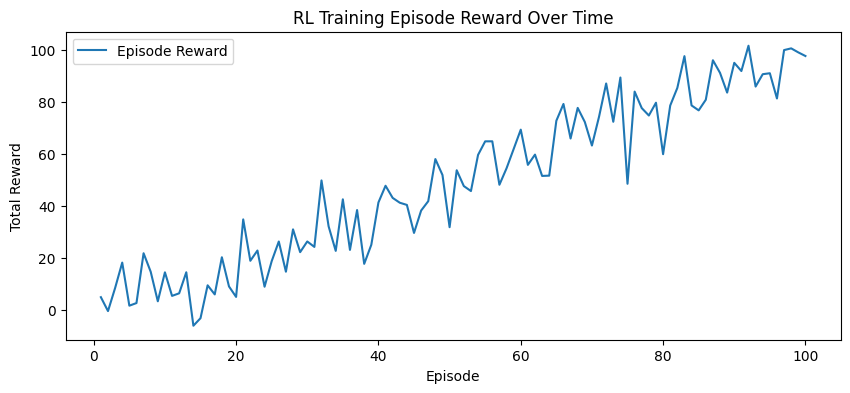

In [ ]:
# cell 2: example plotting of episode rewards (if logged)
import pandas as pd
import matplotlib.pyplot as plt

# assume you saved 'rewards.csv' with columns ['episode','reward']
df = pd.read_csv('rewards.csv')

plt.figure(figsize=(10,4))
plt.plot(df.episode, df.reward, label='Episode Reward')
plt.xlabel('Episode')
plt.ylabel('Total Reward')
plt.title('RL Training Episode Reward Over Time')
plt.legend()
plt.show()


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.


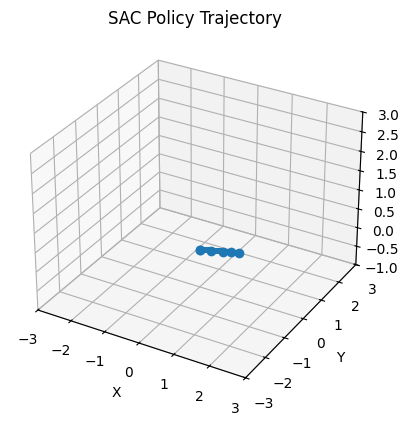

In [ ]:
# ===== Corrected Cell 3: pick one test example and animate its trajectory =====
%load_ext autoreload
%autoreload 2
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML
from fk_utils import forward_kinematics
from stable_baselines3 import SAC
from nao_env import NaoIKEnv

# Reload test data X_test, Y_test as before...
env   = NaoIKEnv(X_test, Y_test)
model = SAC.load("sac_nao_arkoma", env=env)

# Pick sample
idx  = 0
pose = X_test[idx]
obs  = np.concatenate([np.zeros(5), pose])

# Build trajectory
traj = []
done = False
for _ in range(200):
    action, _ = model.predict(obs, deterministic=True)
    obs, _, done, _ = env.step(action)
    traj.append(env.current.copy())    # now exists!
    if done: break
traj = np.array(traj)

# Animate
fig = plt.figure()
ax  = fig.add_subplot(111, projection='3d')
ax.set(xlim=[-3,3], ylim=[-3,3], zlim=[-1,3],
       xlabel='X', ylabel='Y', zlabel='Z',
       title='SAC Policy Trajectory')

first_pos = forward_kinematics(traj[0], env.link_lengths)
line, = ax.plot(first_pos[:,0], first_pos[:,1], first_pos[:,2], 'o-', lw=4)

def animate(i):
    pos = forward_kinematics(traj[i], env.link_lengths)
    line.set_data(pos[:,0], pos[:,1])
    line.set_3d_properties(pos[:,2])
    return (line,)

ani = animation.FuncAnimation(fig, animate,
                              frames=len(traj),
                              interval=50, blit=True)

HTML(ani.to_jshtml())
